## Processing Ocean Color Imagery

This data was collected in a mapping fashion with a constant viewing geometry of 40 and 135

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing

import cv2
import numpy as np
import matplotlib.pyplot as plt

import exiftool
import datetime

import rasterio

from utils import *
from georeg import *

In [3]:
data_dir = os.path.join('data', '20210427_gulf_stream_surveys', 'flight1')
data_dir

'data/20210427_gulf_stream_surveys/flight3'

In [4]:
#grab last 4 characters of the file name:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + 'sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)

In [5]:
! ls data/20210427_gulf_stream_surveys/flight1

all_imgs  chla	panel  rededge	sea  sky


In [ ]:
alta_logs = format_alta_logs(data_dir + 'SYNLog-16-17-34_04-03-2021_edit.csv')
alta_logs.head()

In [8]:
sky_dir = os.path.join(data_dir, 'sky', 'stacks')
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

In [25]:
start = 86
count = 80
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Output shape is:  (80, 6, 1470, 2021)


In [8]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-03-04-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]

In [10]:
sky_imgs, sky_img_metadata = retrieve_imgs_and_metadata(sky_dir, count=12, start=32, altitude_cutoff=0)

Output shape is:  (12, 6, 1469, 2024)


In [26]:
blocked_dir = os.path.join(data_dir, 'rededge', 'tube', 'stacks')
blocked_dir

'data/20210427_gulf_stream_surveys/flight3/rededge/tube/stacks'

In [27]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=100, start=0, altitude_cutoff=0)

Output shape is:  (19, 5, 946, 1248)


In [13]:
sky_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sky_rededge', 'stacks')
surface_dir_re = os.path.join('data', '20210407_duml_full_workflow_test', 'sea_rededge', 'stacks')

In [14]:
sky_re_imgs, sky_re_img_metadata = retrieve_imgs_and_metadata(sky_dir_re, count=100, start=0, altitude_cutoff=0)
sea_re_imgs, sea_re_img_metadata = retrieve_imgs_and_metadata(surface_dir_re, count=100, start=0, altitude_cutoff=0)

Output shape is:  (4, 5, 946, 1267)
Output shape is:  (9, 5, 946, 1267)


only grab metadata

Open the md of each image and then sort by time and then I know the order of pitch

then I can sort by pitch and yaw

In [6]:
band_names = ['blue', 'green', 'red', 'red edge', 'nir']

In [9]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

449

In [50]:
mds[0]

{'Latitude': 34.71564444444445,
 'Longitude': -76.67269444444445,
 'Altitude': 4.5,
 'UTC-Time': '16:16:40',
 'Date': '03/04/2021',
 'full_filename': 'data/20210304_duml_newgimbal_mapping_testing/sky/stacks/a6bBV3Rv9B8b2mTJSN1k.tif',
 'filename': 'a6bBV3Rv9B8b2mTJSN1k.tif',
 'yaw': 287.0456623610269,
 'pitch': 356.5819870769185,
 'roll': 359.1738860005607}

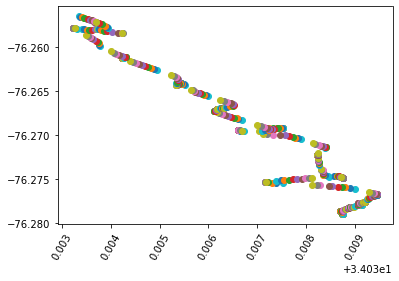

In [10]:
for md in mds:
    plt.scatter(md['Latitude'], md['Longitude'])
    plt.xticks(rotation=60)

In [ ]:
from datetime import datetime
chla_dates = []
for im in img_metadata:
    date_time_str = im['Date'] + ' ' + im['UTC-Time']

    date_time_obj = datetime.strptime(date_time_str, '%m/%d/%Y %H:%M:%S')
    chla_dates.append(date_time_obj)

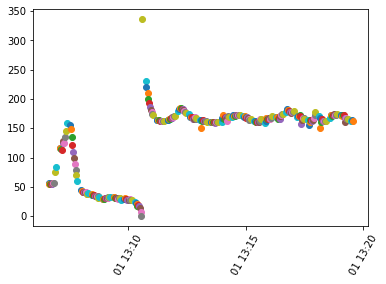

In [18]:
import datetime

for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'])
    plt.xticks(rotation=60)

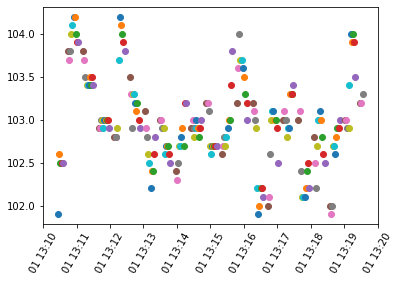

In [24]:
import datetime

for md in mds[84:]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

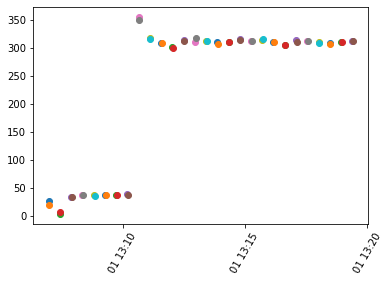

In [13]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['pitch'])
    plt.xticks(rotation=60)

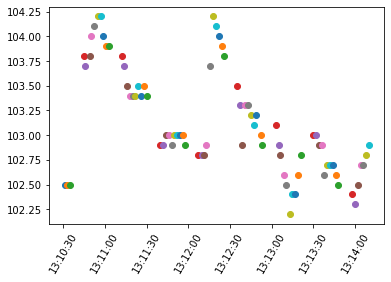

In [29]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

In [30]:
sea_imgs.nbytes / 1e9

11.4081408

In [14]:
sky_imgs.nbytes / 1e9

1.712595456

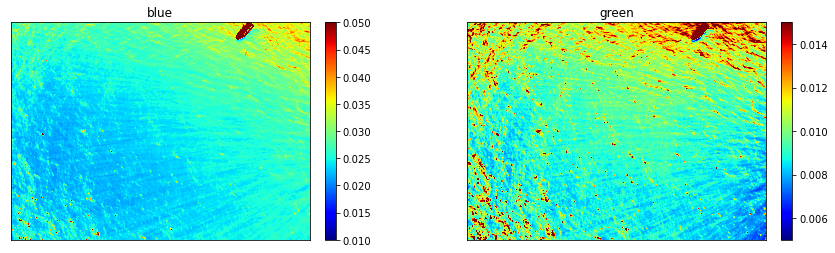

In [64]:
from skimage.transform import resize

for i in range(15):
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.01, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.015)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

    break

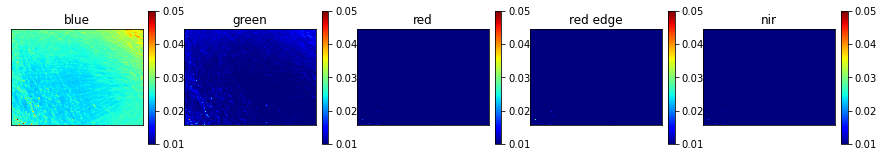

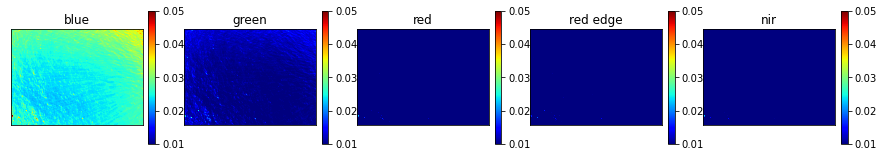

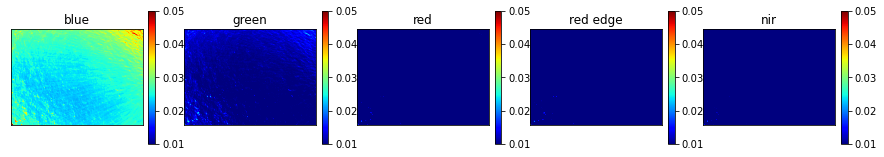

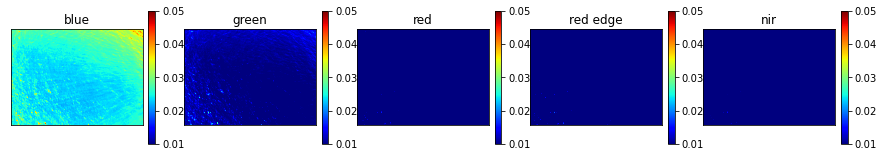

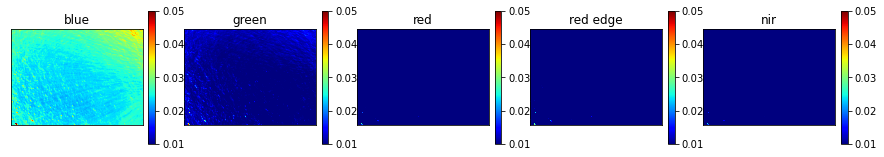

...

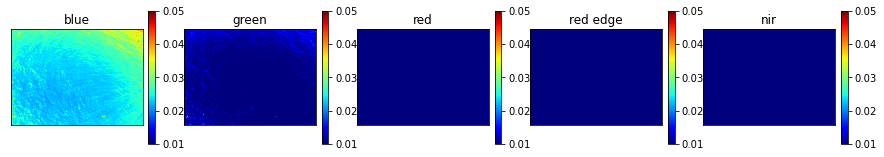

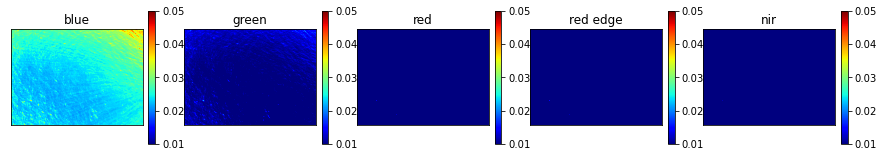

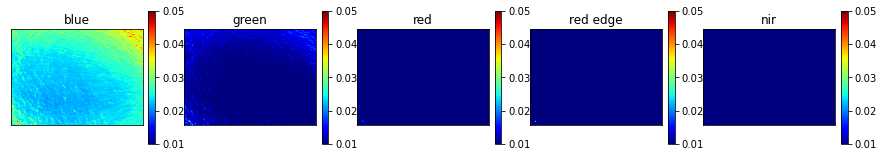

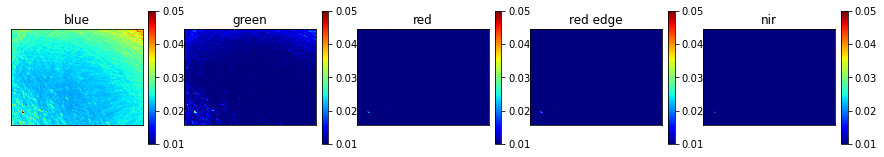

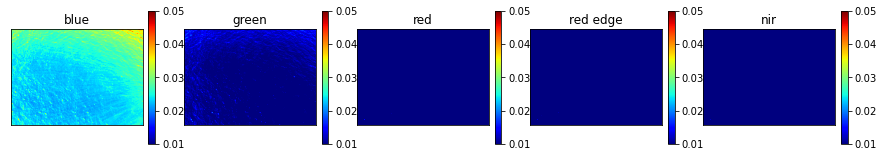

In [49]:
for j in range(25,40):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.01, vmax=.05)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

### create medians of each image

In [25]:
sea_imgs.shape

(60, 6, 1469, 2016)

In [50]:
sea_median = np.median(sea_imgs[25:40], axis=0)

In [27]:
#sky_median = np.median(sky_imgs, axis=0)
sky_median = sky_imgs[7]

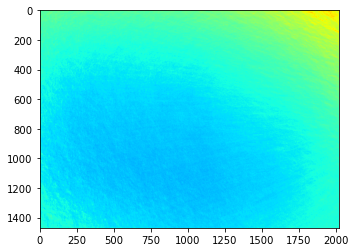

In [54]:
plt.imshow(sea_median[0], vmin=0.01,vmax=.05, cmap='jet')

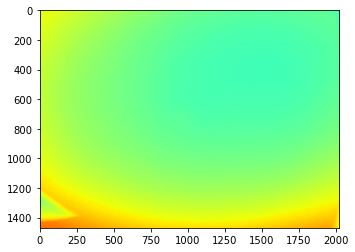

In [29]:
plt.imshow(sky_median[0], vmin=0.01,vmax=.25, cmap='jet')

#### inspect the sun blocked spectra based on the brightest pics there

brightest pixels used: 11806
brightest pixels used: 11806
brightest pixels used: 11806
brightest pixels used: 11806
brightest pixels used: 11806


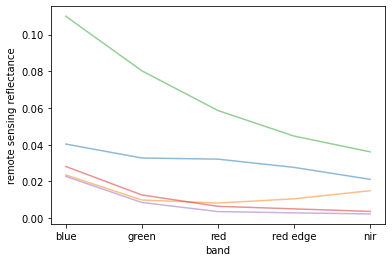

In [74]:
blocked_spectra = []
for i in range(0,5):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.01)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

In [78]:
blocked_spectra[4]

array([0.0227591 , 0.00854833, 0.00360433, 0.00290641, 0.00232428])

In [55]:
np.median(sea_median, axis=(1,2))

array([0.02426147, 0.01016235, 0.00375366, 0.00317383, 0.00244141,
       0.89532471])

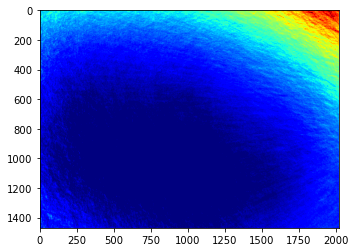

In [87]:
plt.imshow((sea_median[:5].T-blocked_spectra[4]).T[0], vmin=0.0005,vmax=.015, cmap='jet')

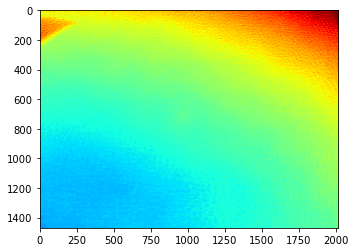

In [32]:
plt.imshow(((sea_median-blocked_spectra[4]) / sky_median[:,::-1,:2016])[0], vmin=0.025,vmax=.2, cmap='jet')

Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

In [ ]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates})

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

In [38]:
from georeg import *

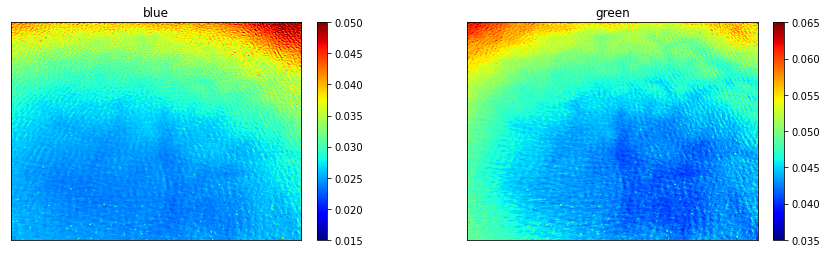

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


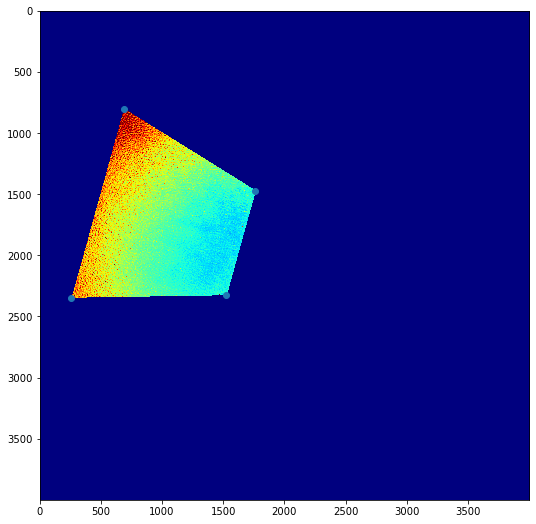

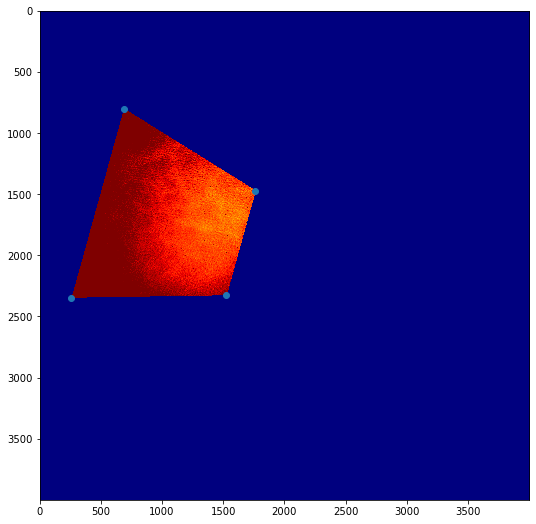

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

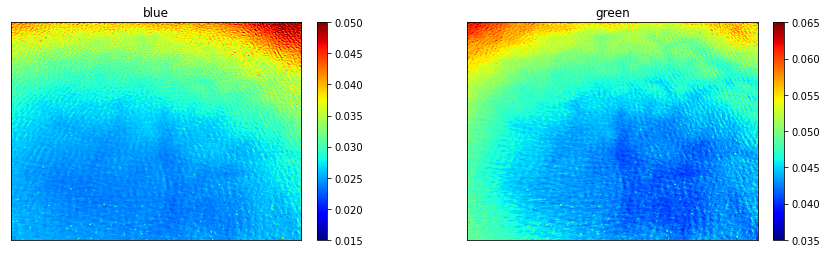

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


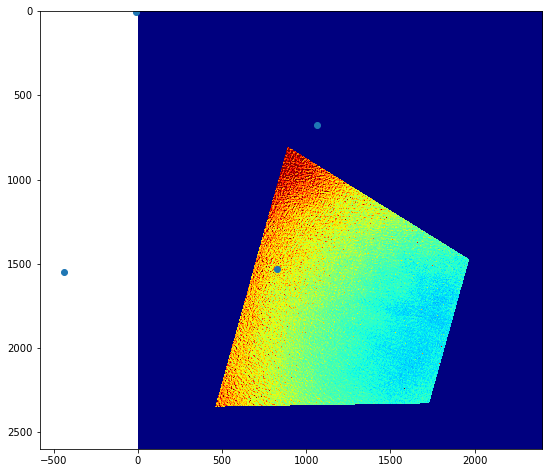

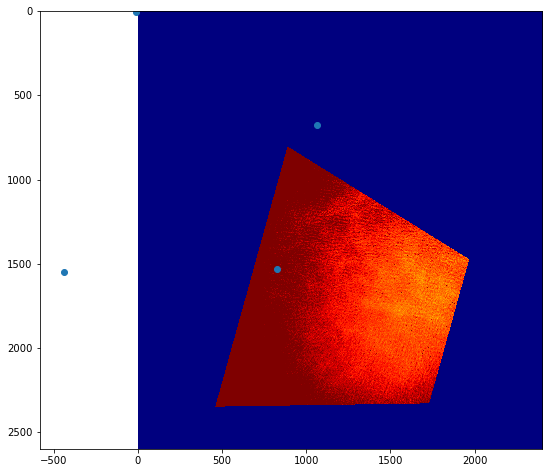

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

### Correct for sun glint

### This is the current approach to calculating rho based on sunblocked spectra

Simple version

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images

Sea median - blocked_spectra is lsky * rho. So then to get Lw in the future all I need to do is subtract that from Lt

In [89]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - blocked_spectra[4]).T), sigma=(0, 10, 10), order=0)

In [90]:
smoothed_lt_lw.shape

(5, 1470, 2021)

Visualize the sea median bands

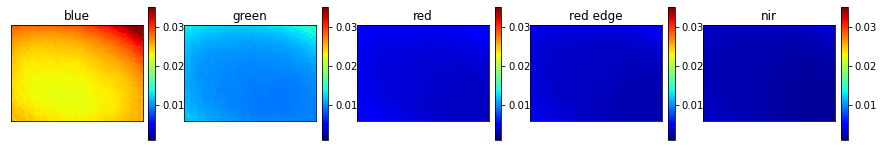

In [93]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.001, vmax=.035)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sea median images divided by image mean

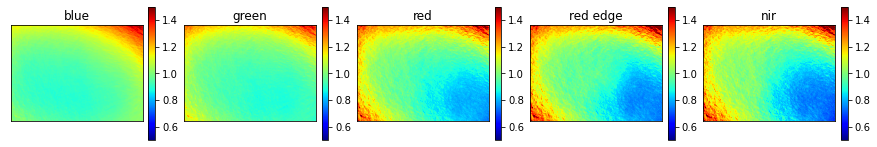

In [94]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median images

NameError: name 'sky_median' is not defined

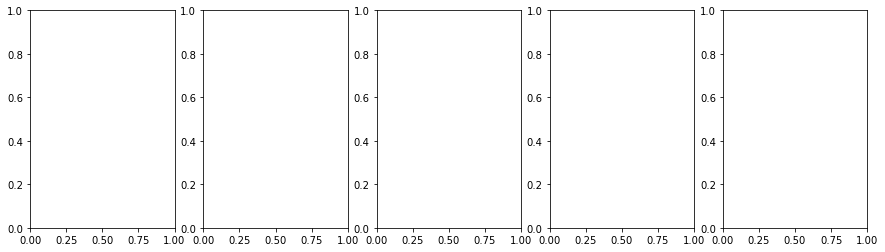

In [95]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i],cmap='jet', vmin=0.003, vmax=.2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Sky median divided by the mean sky median

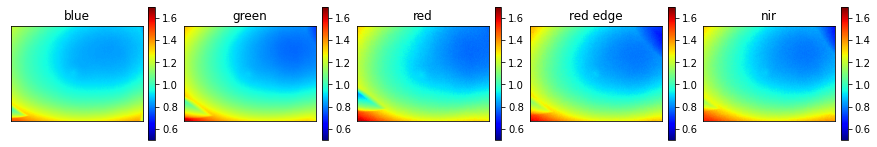

In [28]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sky_median[i]/np.mean(sky_median[i]),cmap='jet', vmin=.5, vmax=1.7)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Smoothed lt - lw images (aka rho*lsky)

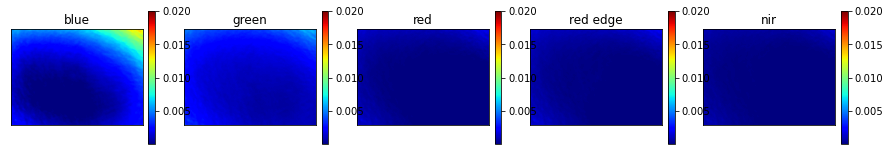

In [99]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.0001, vmax=.02)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

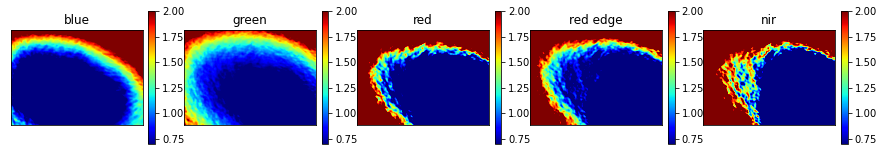

In [102]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt-lw divided by lsky which is effectively rho

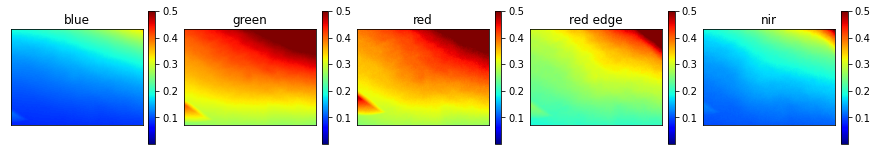

In [31]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/sky_median[i,:,:2016],cmap='jet', vmin=0.001, vmax=.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

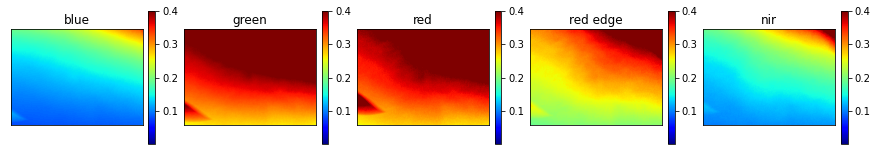

In [32]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/sky_median[i,:,:2016],cmap='jet', vmin=0.001, vmax=.4)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

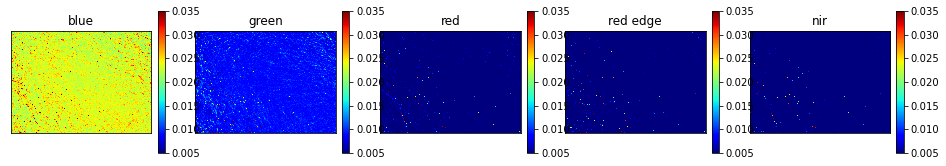

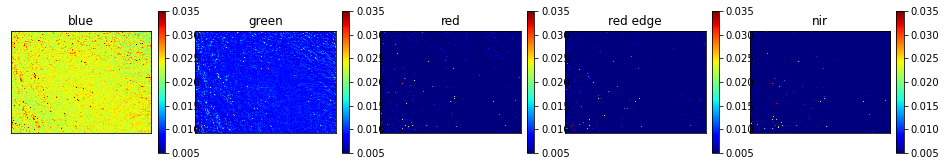

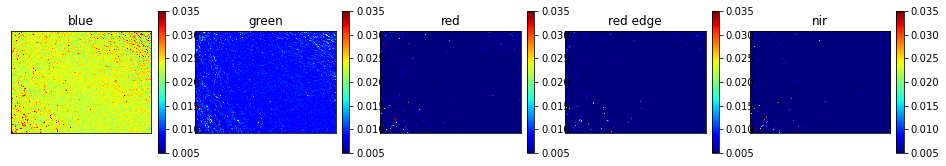

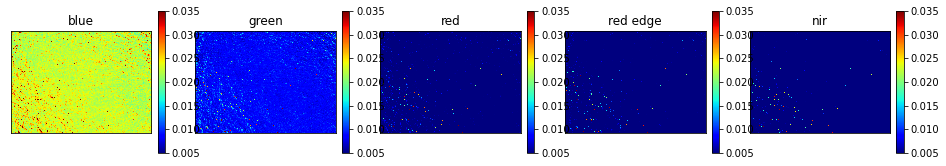

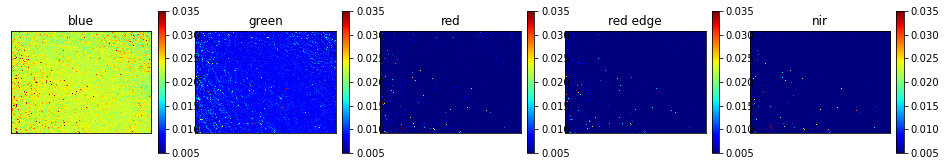

...

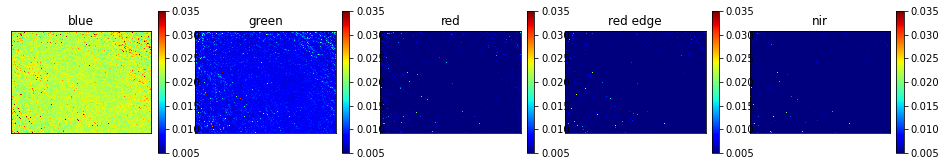

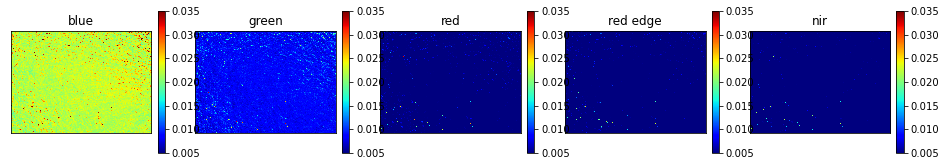

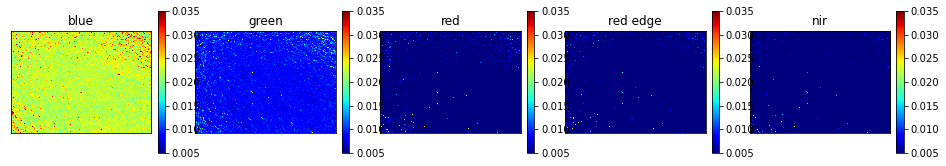

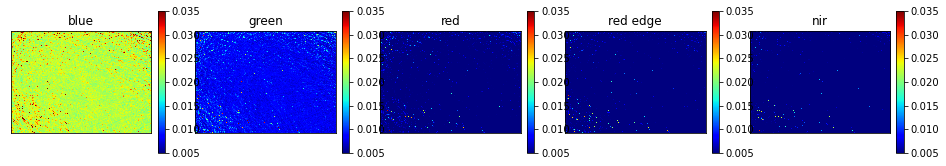

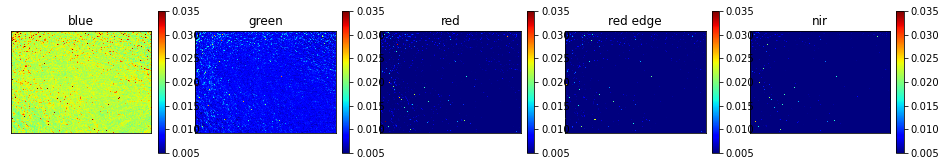

In [105]:
for i in range(25,40):
    visualize_darkest_pixels(sea_imgs[i,:5] - smoothed_lt_lw, lowest_percent=1, max_clim=0.035, min_clim=0.005, only_img=True)

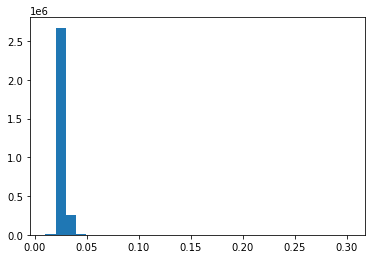

In [109]:
plt.hist(sea_imgs[0,0].flatten(), bins=30)
plt.show()

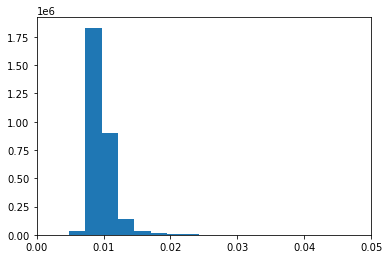

In [120]:
plt.hist(sea_imgs[0,1].flatten(), bins=150)
plt.xlim(0,0.05)
plt.show()

In [118]:
np.max(sea_imgs[0,0])

0.302978515625

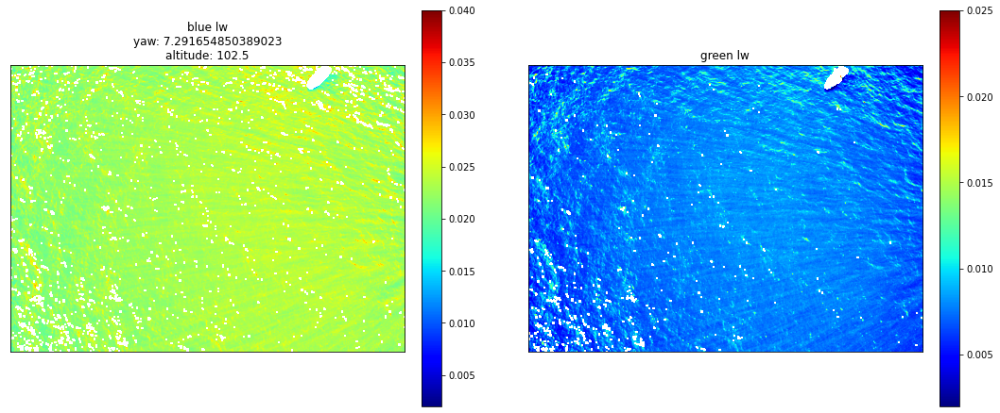

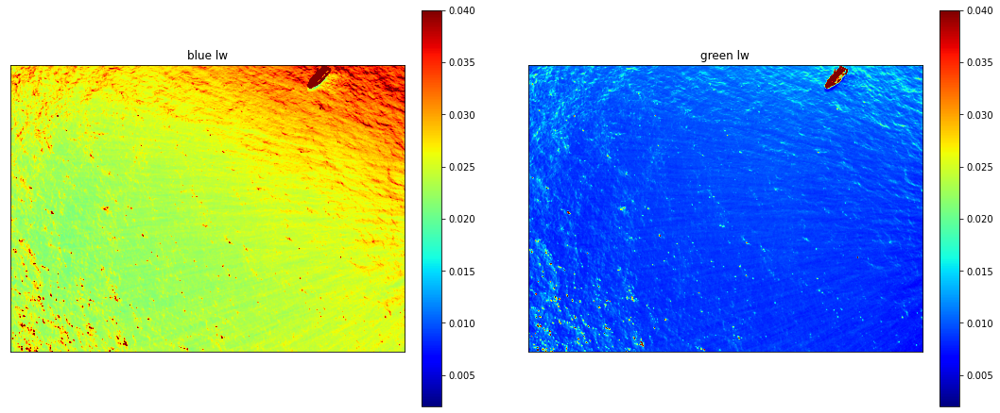

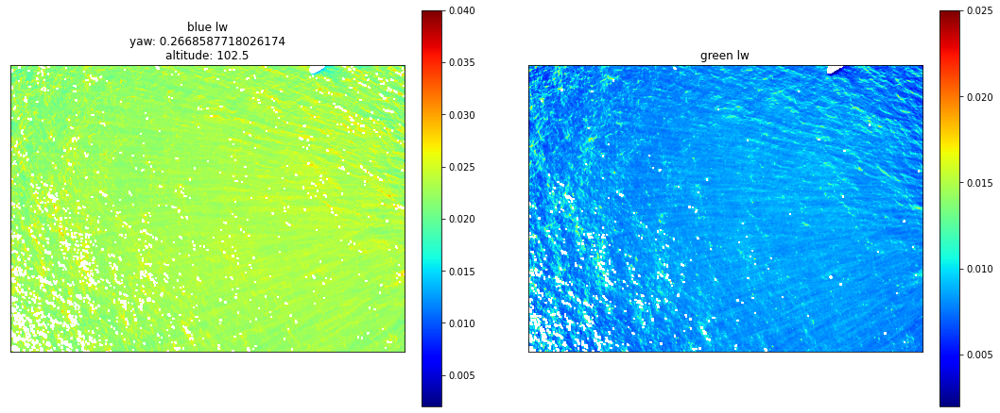

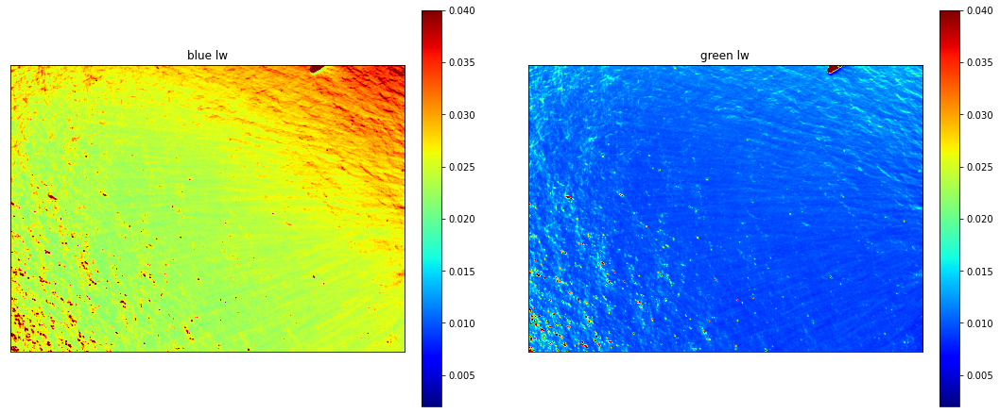

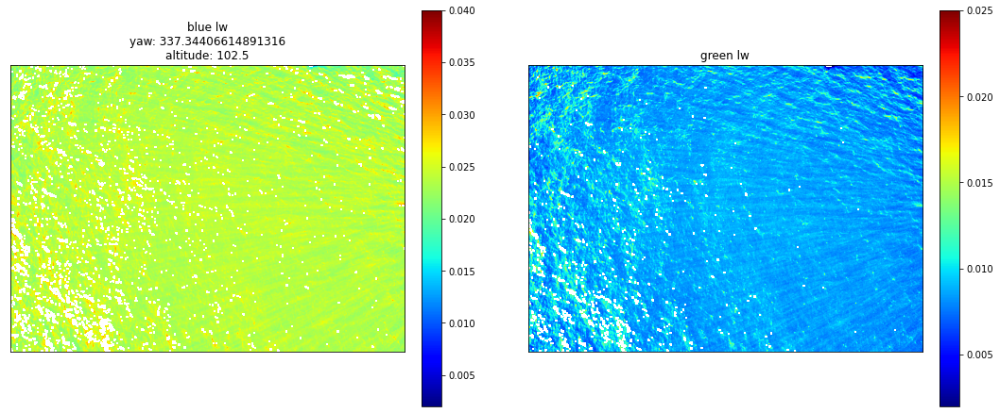

...

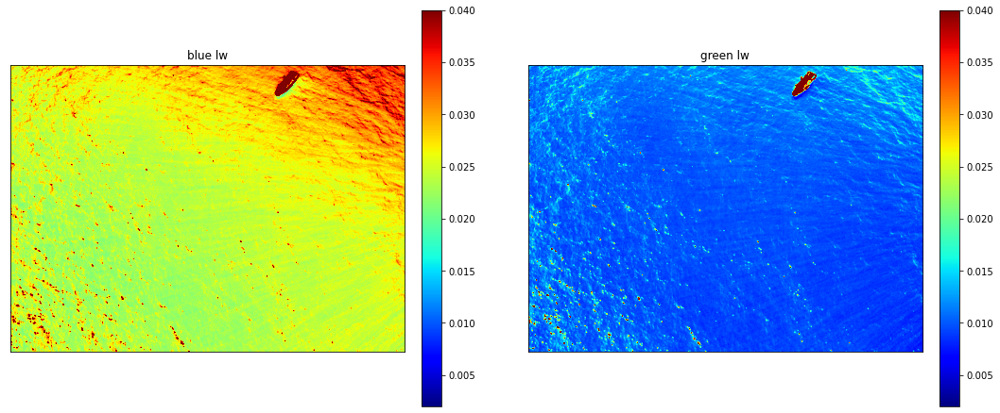

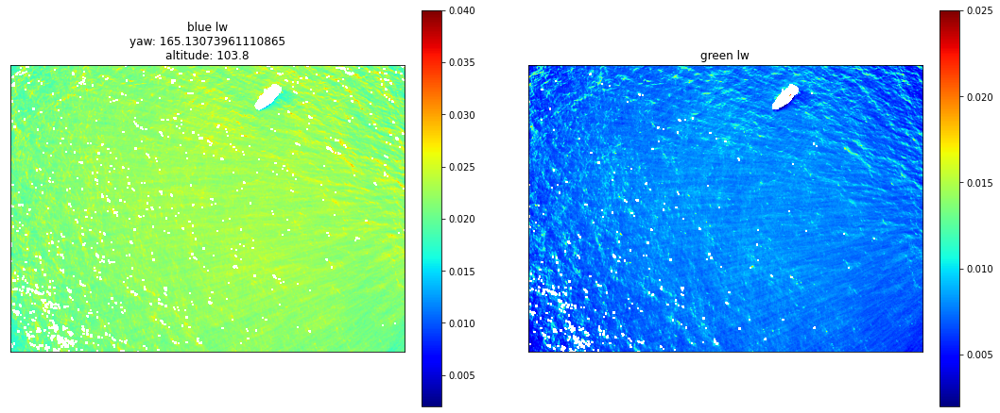

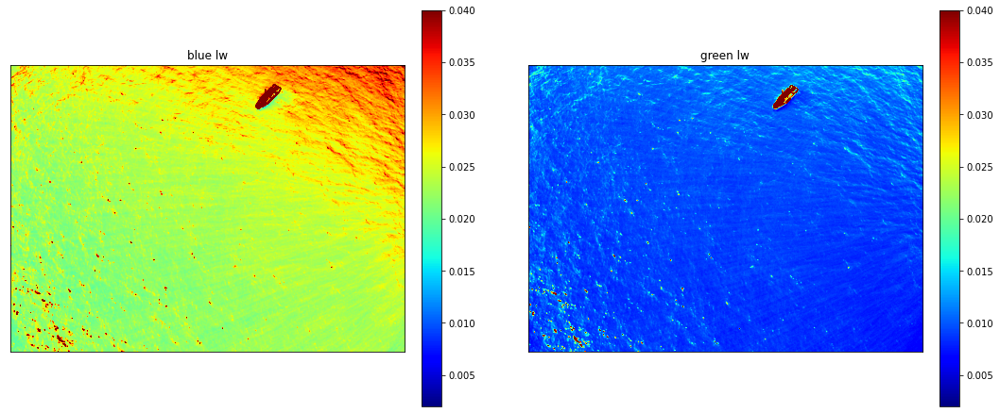

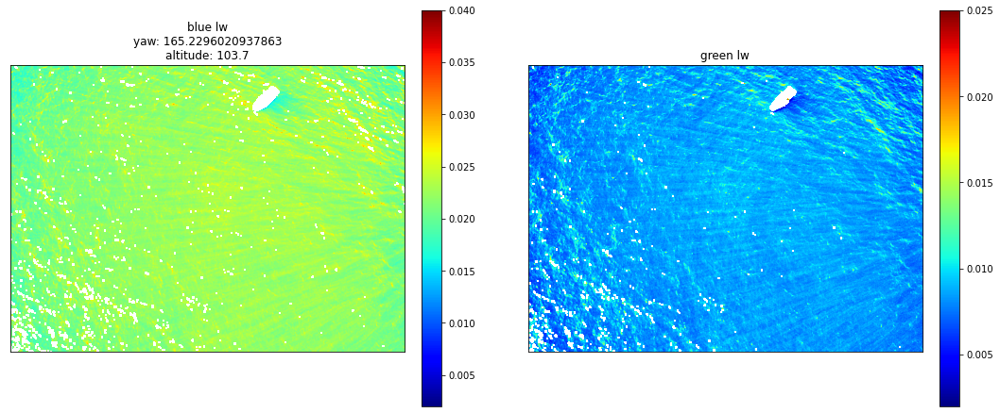

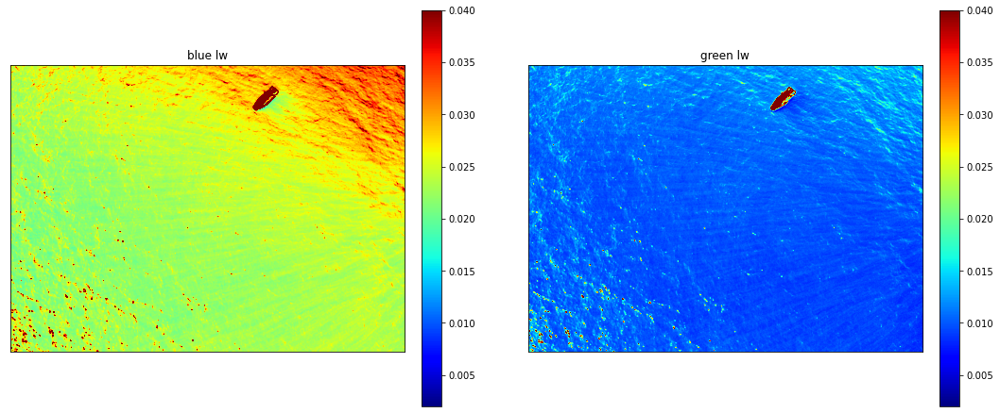

In [127]:
for i in range(15):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.035] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.002, vmax=.04)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.002, vmax=.025)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.002, vmax=.04)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.002, vmax=.04)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
        
#     original_img = plt.imread(sea_img_metadata[i]['image_name'])
#     resized_blue = resize(img[0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
#     resized_green = resize(img[1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
#     new_name = 'lw_blue_georeg_finer' + sea_img_metadata[i]['filename']
#     alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, scaling=0.05)
#     new_name = 'lw_green_georeg_finer' + sea_img_metadata[i]['filename']
#     alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, scaling=0.05)
#     break
    
    
# from skimage.transform import resize

# for i in range(15):
    
#     # form is [x_min, x_max, y_min, y_max]
#     top_im_bounds=[-100,100,-100,100]
    
#     original_img = plt.imread(sea_img_metadata[i]['image_name'])
#     resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
#     resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
#     smoothed_lt_lw
#     resized_blue[resized_blue < 0] = 0
#     resized_green[resized_green < 0] = 0
    
#     fig, ax = plt.subplots(1,2, figsize=(15,4))
#     im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
#     fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
#     ax[0].set_xticks([])
#     ax[0].set_yticks([])
#     ax[0].set_title('blue')
    
#     im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
#     fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
#     ax[1].set_xticks([])
#     ax[1].set_yticks([])
#     ax[1].set_title('green')
#     plt.show()
#     new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
#     alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
#     new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
#     alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
#     break

#### Inspect the spectra from this

In [129]:
chla_lw = vec_chla_img(img[0], img[1])

/home/clifgray/Code/ocean_color/utils.py:550: RuntimeWarning: invalid value encountered in log10
  + a4 * (np.log10(blue / green))**4


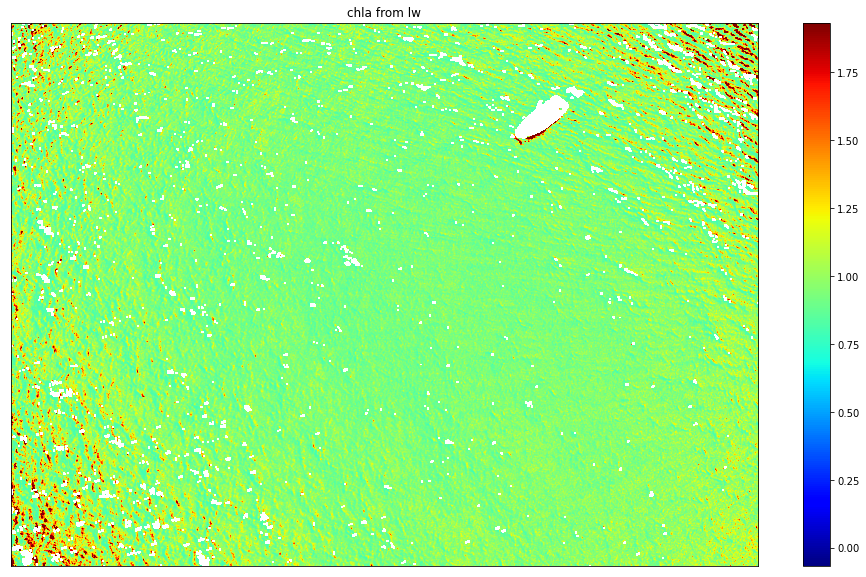

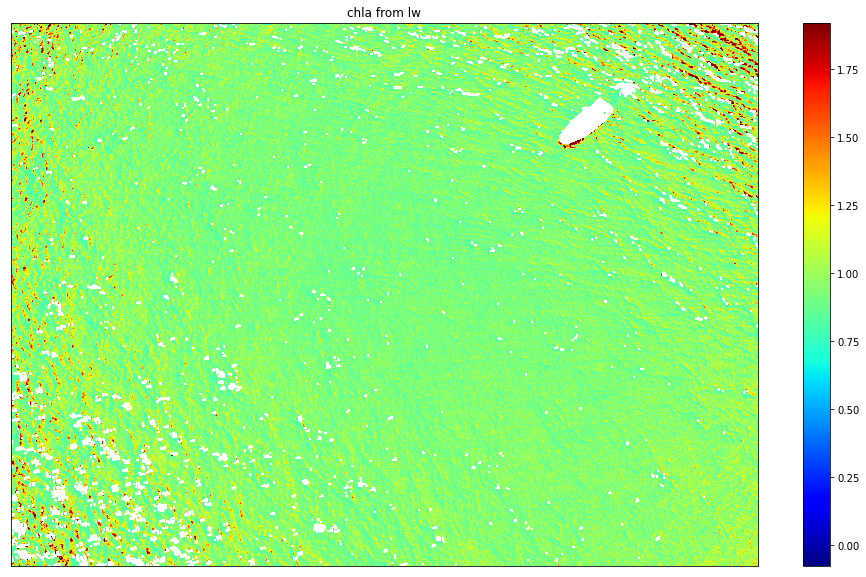

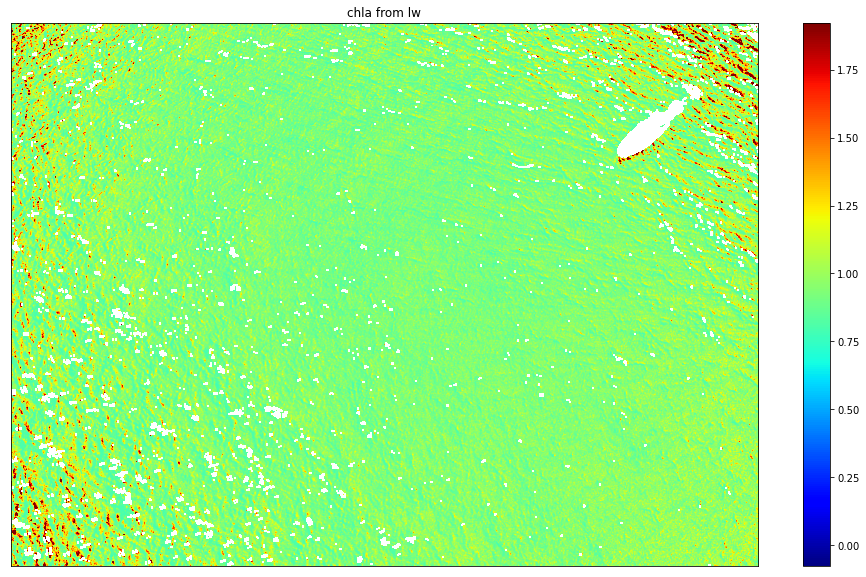

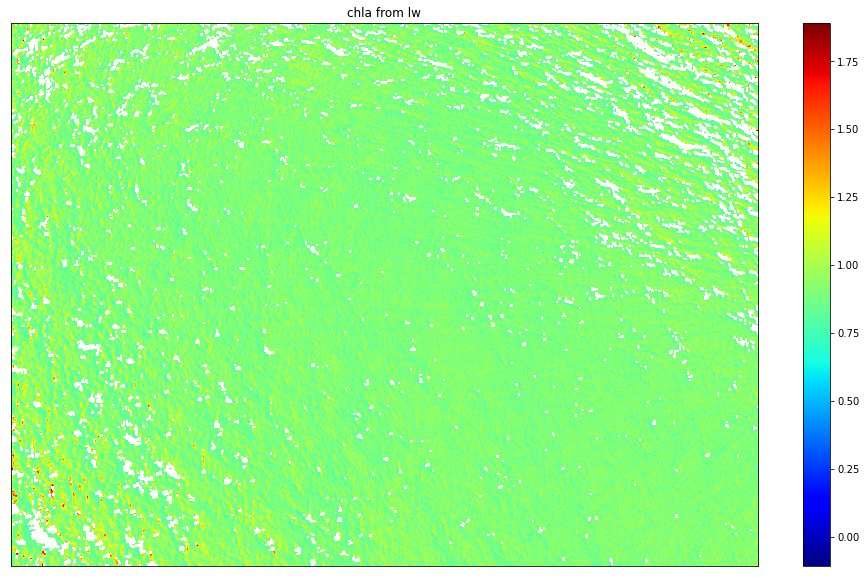

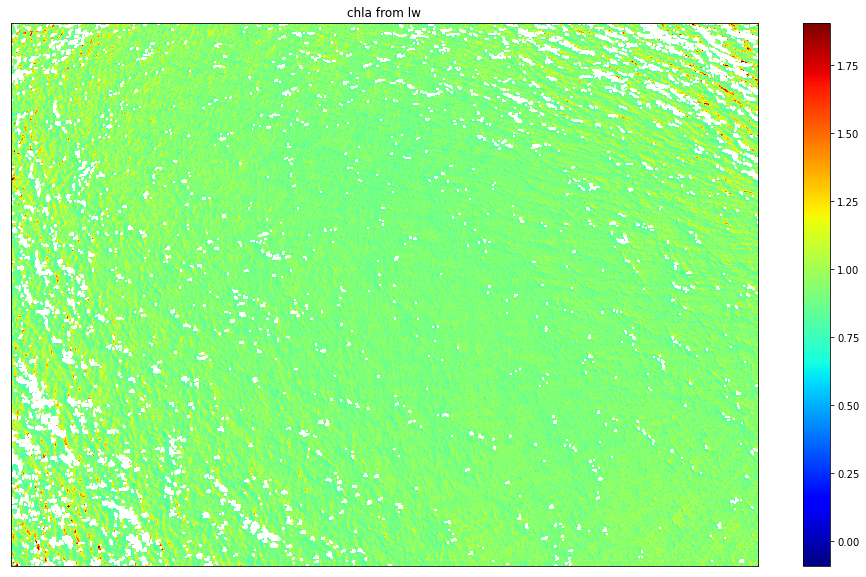

...

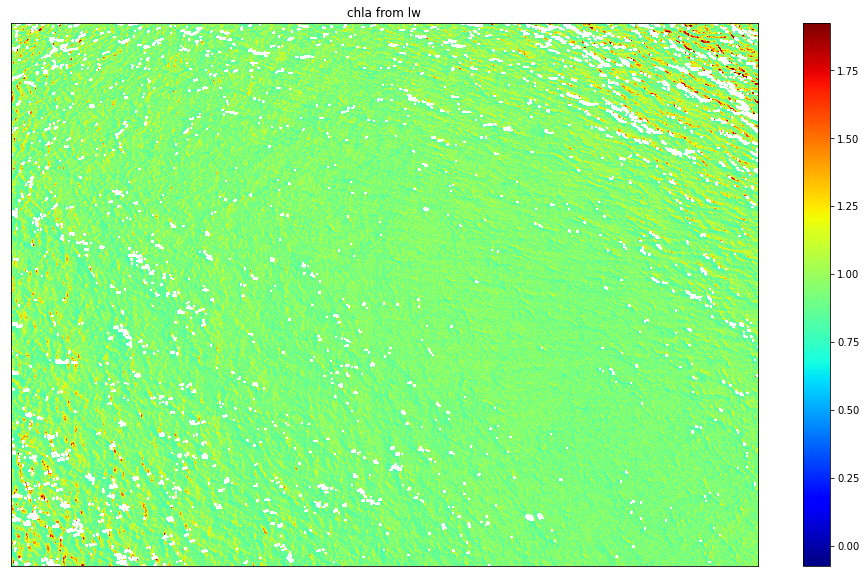

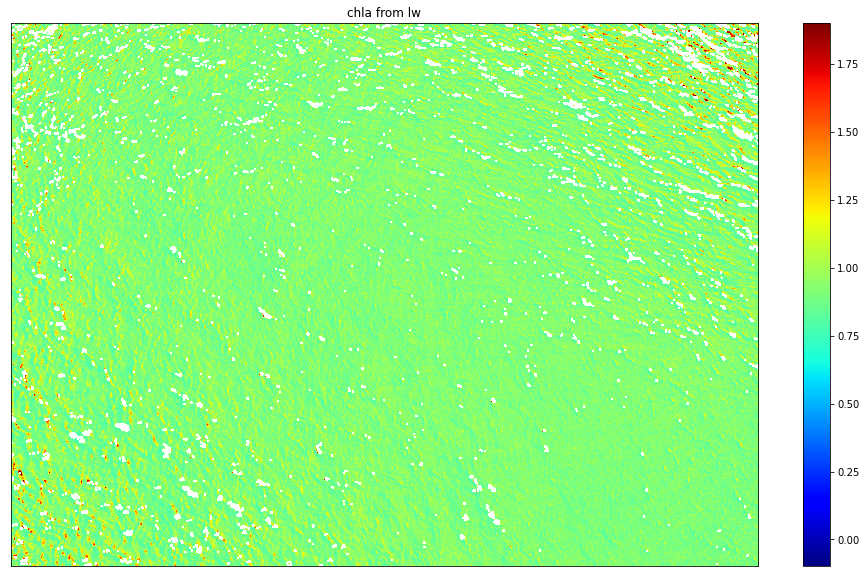

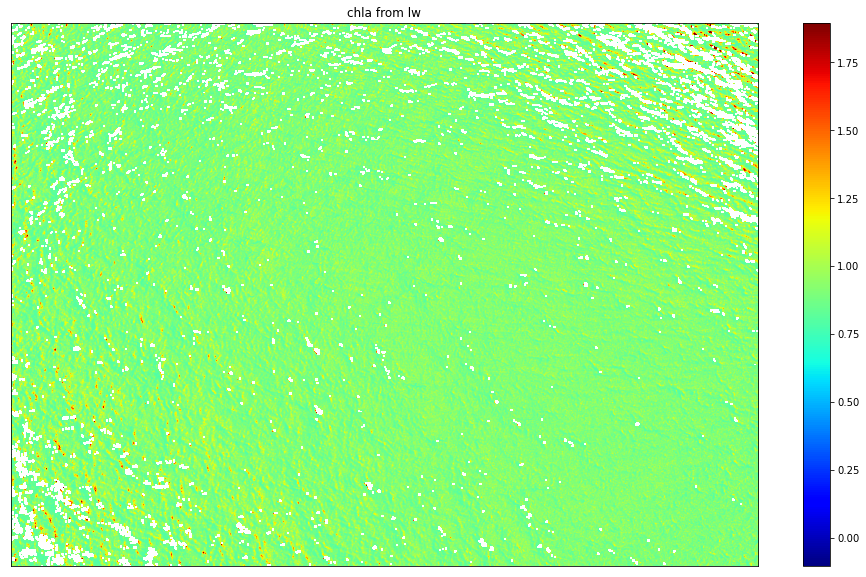

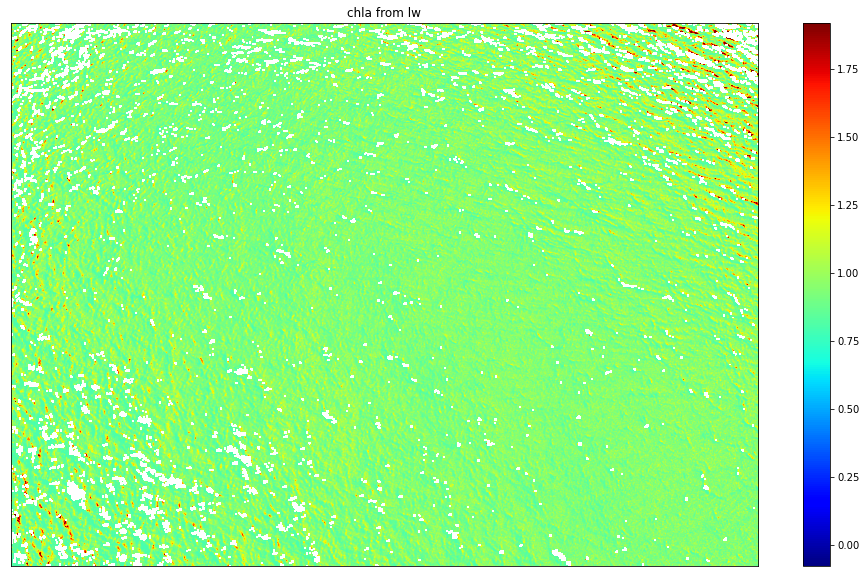

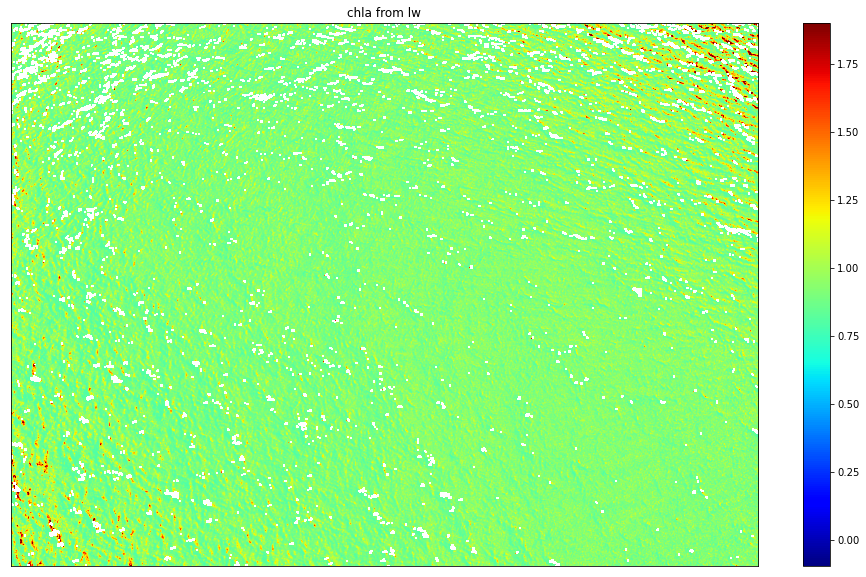

In [139]:
for i in range(20,40):
    fig, ax = plt.subplots(1, figsize=(20,10))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    img[img > 0.03] = np.nan
    
    chla_lw = vec_chla_img(img[0], img[1])
    im = ax.imshow(chla_lw,cmap='jet', vmin=np.nanmedian(chla_lw)-1, vmax=np.nanmedian(chla_lw)+1)
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()

In [134]:
np.nanmedian(chla_lw)

1.0651143557227716

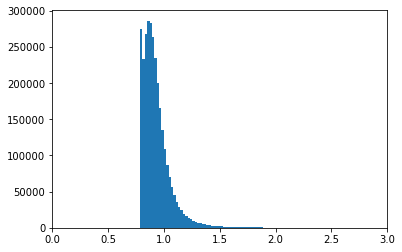

In [145]:
plt.hist(chla_lw.flatten(), bins=1200)
plt.xlim(0,3)
plt.show()

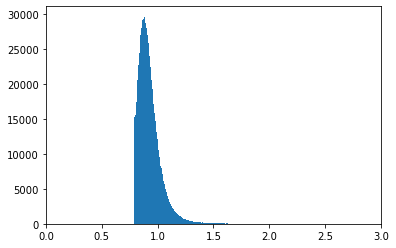

In [147]:
plt.hist(chla_lw[500:, 200:-200].flatten(), bins=1200)
plt.xlim(0,3)
plt.show()

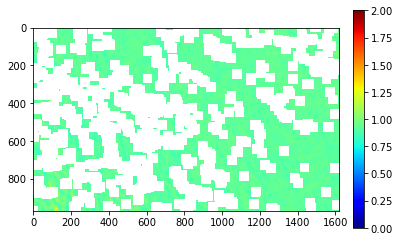

In [148]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_lw[500:, 200:-200], sigma=(5, 5), order=0), cmap='jet', vmin=0,vmax=2)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Inspect the data geographically

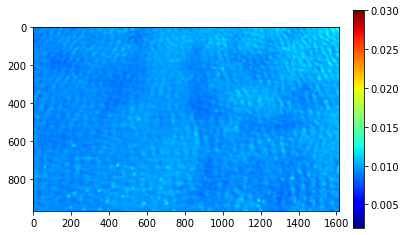

In [69]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(img[0,500:, 200:-200], sigma=(5, 5), order=0), cmap='jet', vmin=0.002, vmax=.03)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

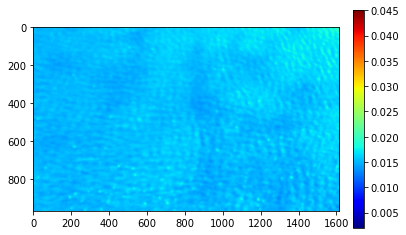

In [70]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(img[1,500:, 200:-200], sigma=(5, 5), order=0), cmap='jet', vmin=0.002, vmax=.045)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

In [ ]:
for i in range(0,19):
    fig, ax = plt.subplots(1,6, figsize=(15,3))
    print('pitch:',sea_img_md_pitch_sort[i]['pitch'])
    print('yaw:',sea_img_md_pitch_sort[i]['yaw'])
    ax[0].set_title("Blue")
    im = ax[0].imshow(sea_imgs[sea_img_md_pitch_sort[i]['id'],0], interpolation='none', 
                   cmap='jet', vmin=0.02, vmax=.06)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    #fig.colorbar(im,ax=ax[0])
    ax[1].set_title("Green")
    im2 = ax[1].imshow(sea_imgs[sea_img_md_pitch_sort[i]['id'],1], interpolation='none', 
                   cmap='jet', vmin=0.02, vmax=.06)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    #fig.colorbar(im2,ax=ax[1])
    im3 = ax[2].imshow(sea_imgs[sea_img_md_pitch_sort[i]['id'],2], interpolation='none', 
                   cmap='jet', vmin=0.02, vmax=.06)
    ax[2].set_xticks([])
    ax[2].set_yticks([])
    #fig.colorbar(im2,ax=ax[2])
    im4 = ax[3].imshow(sea_imgs[sea_img_md_pitch_sort[i]['id'],3], interpolation='none', 
                   cmap='jet', vmin=0.02, vmax=.06)
    ax[3].set_xticks([])
    ax[3].set_yticks([])
    #fig.colorbar(im2,ax=ax[3])
    im5 = ax[4].imshow(sea_imgs[sea_img_md_pitch_sort[i]['id'],4], interpolation='none', 
                   cmap='jet', vmin=0.02, vmax=.06)
    ax[4].set_xticks([])
    ax[4].set_yticks([])
    ax[5].set_title("Blue/Green")
    im6 = ax[5].imshow(sea_imgs[sea_img_md_pitch_sort[i]['id'],0]/sea_imgs[sea_img_md_pitch_sort[i]['id'],1], interpolation='none', 
                   cmap='YlGnBu', vmin=.5, vmax=1.2)
    ax[5].set_xticks([])
    ax[5].set_yticks([])
    #fig.colorbar(im2,ax=ax[4])
    plt.show()